In [100]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import metrics
import klib as kl
from ucimlrepo import fetch_ucirepo 
  

Predicting rings or age

In [101]:
train = pd.read_csv('data/train.csv')
test = pd.read_csv('data/test.csv')

train.shape

(90615, 10)

In [102]:
train.head()

,id,Sex,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight,Rings
0,0,F,0.550,0.430,0.150,0.7715,0.3285,0.1465,0.2400,11
1,1,F,0.630,0.490,0.145,1.1300,0.4580,0.2765,0.3200,11
2,2,I,0.160,0.110,0.025,0.0210,0.0055,0.0030,0.0050,6
3,3,M,0.595,0.475,0.150,0.9145,0.3755,0.2055,0.2500,10
4,4,I,0.555,0.425,0.130,0.7820,0.3695,0.1600,0.1975,9


In [103]:
train = kl.clean_column_names(train)
test = kl.clean_column_names(test)

In [104]:
kl.missingval_plot(train)

No missing values found in the dataset.


In [105]:
train.columns = ['id', 'sex', 'length', 'diameter', 'height', 'whole_weight',
       'weight_of_meat', 'gut_weight', 'shell_weight', 'rings']
test.columns =  ['id', 'sex', 'length', 'diameter', 'height', 'whole_weight',
       'weight_of_meat', 'gut_weight', 'shell_weight']

In [106]:
train.sex.value_counts()

sex
I    33093
M    31027
F    26495
Name: count, dtype: int64

In [107]:
# one hot encode sex 
train = pd.get_dummies(train, columns=['sex'])
test = pd.get_dummies(test, columns=['sex'])

In [108]:
# get all cols with sex in it 

sex_cols = [col for col in train.columns if 'sex' in col]

train[sex_cols] = train[sex_cols].astype(int)
test[sex_cols] = test[sex_cols].astype(int)


### Feature Engineering

In [109]:
train.head()

,id,length,diameter,height,whole_weight,weight_of_meat,gut_weight,shell_weight,rings,sex_F,sex_I,sex_M
0,0,0.550,0.430,0.150,0.7715,0.3285,0.1465,0.2400,11,1,0,0
1,1,0.630,0.490,0.145,1.1300,0.4580,0.2765,0.3200,11,1,0,0
2,2,0.160,0.110,0.025,0.0210,0.0055,0.0030,0.0050,6,0,1,0
3,3,0.595,0.475,0.150,0.9145,0.3755,0.2055,0.2500,10,0,0,1
4,4,0.555,0.425,0.130,0.7820,0.3695,0.1600,0.1975,9,0,1,0


In [110]:
    
def feature_engineer(df):

    # Add features with error handling
    def calculate_feature_safe(numerator, denominator):
        result = numerator / denominator
        result[denominator == 0] = 0  # Set to 0 if denominator is 0
        result[~np.isfinite(result)] = 0  # Set to 0 if result is infinity or NaN
        return result

    df['volume'] = df['length'] * df['diameter'] * df['height']

    df['shell_surface_area'] = 2 * (df['length'] * df['diameter'] + df['length'] * df['height'] + df['diameter'] * df['height'])

    df['meat_to_shell_ratio'] = calculate_feature_safe(df['weight_of_meat'], df['shell_weight'])

    df['density'] = calculate_feature_safe(df['whole_weight'], df['volume'])

    df['length_to_diameter_ratio'] = calculate_feature_safe(df['length'], df['diameter'])

    df['shell_thickness'] = calculate_feature_safe(df['shell_weight'], df['shell_surface_area'])

    df['meat_density'] = calculate_feature_safe(df['weight_of_meat'], df['volume'])

    df['gut_density'] = calculate_feature_safe(df['gut_weight'], df['volume'])

    df['shape_index'] = calculate_feature_safe(df['length'] * df['diameter'] * df['diameter'], 4/3 * 3.14 * (df['diameter']/2) * (df['diameter']/2) * df['height'])

    df['viscera_to_meat_ratio'] = calculate_feature_safe(df['gut_weight'], df['weight_of_meat'])

    df['relative_shell_weight'] = calculate_feature_safe(df['shell_weight'], df['whole_weight'])

    #

    return df


train = feature_engineer(train)
test = feature_engineer(test)

# Exploring the data

In [111]:
# get rid of id column
train = train.drop('id', axis=1)


In [112]:

import plotly.express as px

fig = px.scatter_matrix(train, dimensions=train.columns,
                        color='rings')
# increase the size of the plots
fig.update_traces(diagonal_visible=False)
fig.update_layout(
    autosize=False,
    width=1600,
    height=1600,
)
fig.show()

just based on how the weights are looking, there seems to be a lot of non linear correlation. 

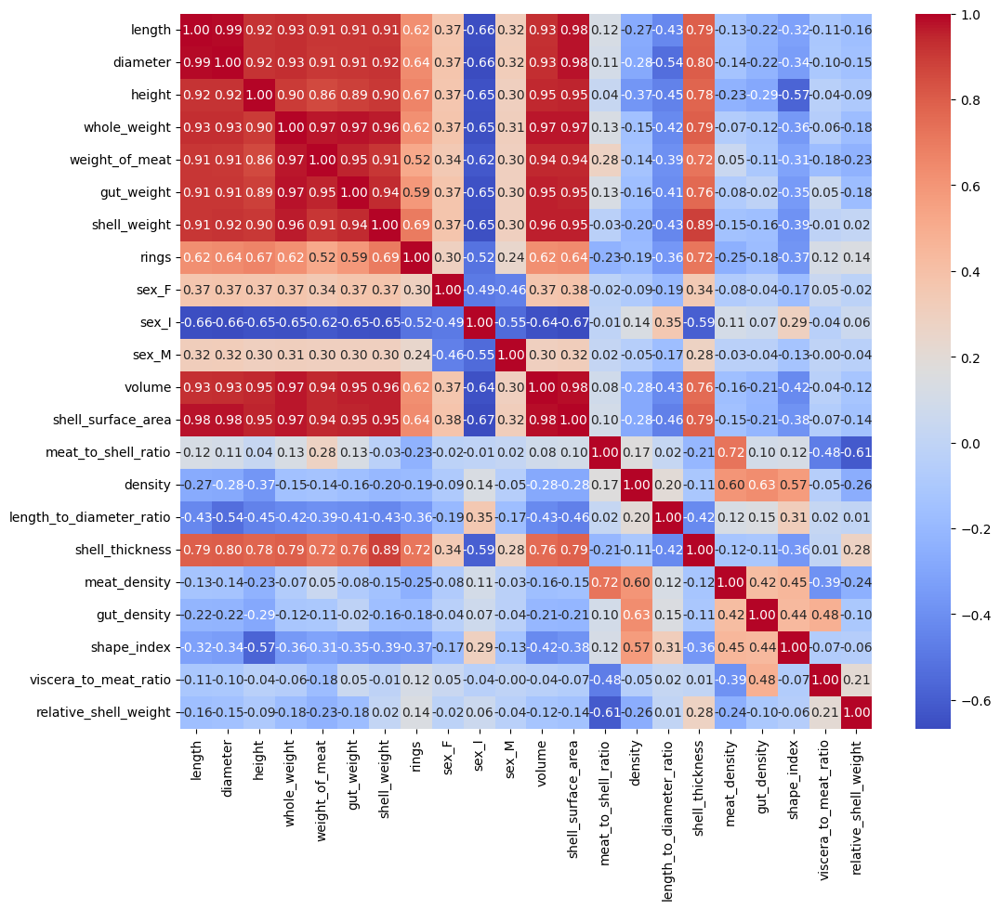

In [113]:
# looking at a correlation matrix
corr = train.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

shell thickness looks promising

In [114]:
# plotting skew and kurtosis of each column
skew = train.skew()
kurt = train.kurt()

# plot with plotly express
fig = px.scatter(x=skew.index, y=skew.values, labels={'x': 'Column', 'y': 'Skewness'}, title='Skewness of each column')
fig.show()


A skewness of 0 means that the data is normally distributed. A good rule of thumb is that if the skewness is less than -1 or greater than 1, the data are highly skewed. If the skewness is between -1 and -0.5 or between 0.5 and 1, the data are moderately skewed. If the skewness is between -0.5 and 0.5, the data are approximately normally distributed.

Based on our data we will use +/- .5

In [115]:

fig = px.scatter(x=kurt.index, y=kurt.values, labels={'x': 'Column', 'y': 'Kurtosis'}, title='Kurtosis of each column')
fig.show()

Kurtosis of 0 is normal. Greater than 0 is fat tails, less than 0 is skinny tails. A good rule of thumb is that if the kurtosis is greater than 3, the data are heavy-tailed or profusion of outliers. If the kurtosis is less than 3, the data are light-tailed or lack of outliers.

We will treat the height variable by imputing outliers. 

In [116]:
# check feature importance with random forest

from sklearn.ensemble import RandomForestRegressor

X = train.drop('rings', axis=1)
y = train['rings']

rf = RandomForestRegressor()
rf.fit(X, y)

feature_importances = pd.Series(rf.feature_importances_, index=X.columns)
feature_importances = feature_importances.sort_values(ascending=False)

fig = px.bar(x=feature_importances.index, y=feature_importances.values, labels={'x': 'Feature', 'y': 'Importance'}, title='Feature Importance')
fig.show()

## Preprocessing

#### Treating kurtosis first

In [88]:
kurt_cols = kurt[kurt > 5].index
len(kurt_cols)

9

In [89]:

for col in kurt_cols:
    # remove outliers from height column with iqr
    Q1 = train[col].quantile(0.25)
    Q3 = train[col].quantile(0.75)
    IQR = Q3 - Q1

    # set outlier values to nan
    train.loc[(train[col] < (Q1 - 1.5 * IQR)) | (train[col] > (Q3 + 1.5 * IQR)), col] = np.nan
    test.loc[(test[col] < (Q1 - 1.5 * IQR)) | (test[col] > (Q3 + 1.5 * IQR)), col] = np.nan

train.isna().sum()

length                         0
diameter                       0
height                       348
whole_weight                   0
weight_of_meat                 0
gut_weight                     0
shell_weight                   0
rings                          0
sex_F                          0
sex_I                          0
sex_M                          0
volume                       348
shell_surface_area           348
meat_to_shell_ratio         1119
density                     3027
length_to_diameter_ratio    3300
shell_thickness             1762
meat_density                2093
gut_density                 2758
shape_index                 2067
viscera_to_meat_ratio       2509
relative_shell_weight       2446
dtype: int64

In [92]:
x_cols = train.columns.drop('rings')

In [93]:

# impute missing values with KNN 
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=5)

train[x_cols] = pd.DataFrame(imputer.fit_transform(train[x_cols]), columns=x_cols)
test[x_cols] = pd.DataFrame(imputer.transform(test[x_cols]), columns=x_cols)

In [94]:
kurt = train.kurt()

fig = px.scatter(x=kurt.index, y=kurt.values, labels={'x': 'Column', 'y': 'Kurtosis'}, title='Kurtosis of each column')
fig.show()

In [95]:
# now log scaling the columns with high skewness
skew = train.skew()

# get columns with abs skewness > .5
high_skew_cols = list(skew[abs(skew) > .5].index)
high_skew_cols.remove('rings')

# log scaling
train[high_skew_cols] = np.log1p(train[high_skew_cols])
test[high_skew_cols] = np.log1p(test[high_skew_cols])


In [96]:
# plotting skew and kurtosis of each column
skew = train.skew()

# plot with plotly express
fig = px.scatter(x=skew.index, y=skew.values, labels={'x': 'Column', 'y': 'Skewness'}, title='Skewness of each column')
fig.show()


### Scaling

In [97]:
# robust scale columns with high skew
from sklearn.preprocessing import RobustScaler, StandardScaler

scaler = RobustScaler()

skew_cols = skew[abs(skew) > .5].index
skew_cols = skew_cols.drop('rings')

train[skew_cols] = scaler.fit_transform(train[skew_cols])
test[skew_cols] = scaler.transform(test[skew_cols])

# standard scale the rest
scaler = StandardScaler()

std_scale_cols = x_cols.difference(skew_cols)

train[std_scale_cols] = scaler.fit_transform(train[std_scale_cols])
test[std_scale_cols] = scaler.transform(test[std_scale_cols])

In [98]:
# saving the cleaned data
train.to_csv('data/train_cleaned_v2.csv', index=False)
test.to_csv('data/test_cleaned_v2.csv', index=False)

In [99]:
# check feature importance with random forest

from sklearn.ensemble import RandomForestRegressor

X = train.drop('rings', axis=1)
y = train['rings']

rf = RandomForestRegressor()
rf.fit(X, y)

feature_importances = pd.Series(rf.feature_importances_, index=X.columns)
feature_importances = feature_importances.sort_values(ascending=False)

fig = px.bar(x=feature_importances.index, y=feature_importances.values, labels={'x': 'Feature', 'y': 'Importance'}, title='Feature Importance')
fig.show()

In [118]:
# only select features with importance > 0.015

feature_importances = feature_importances.loc[feature_importances > 0.015]
list(feature_importances.index)

['shell_weight',
 'meat_to_shell_ratio',
 'whole_weight',
 'shell_thickness',
 'shape_index',
 'relative_shell_weight',
 'length_to_diameter_ratio',
 'density',
 'viscera_to_meat_ratio',
 'gut_density',
 'meat_density',
 'gut_weight',
 'weight_of_meat']